In [1]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib.colors import LinearSegmentedColormap
from IPython.display import HTML
from tqdm import tqdm
from PIL import Image
import numpy as np
import requests
import io
from IPython.display import HTML
from scipy import stats
import random

In [2]:
# Courtesy Prof. Scheffler 
# Downloading data and converting it to a numpy array
# Specify the URL of the data tile
url = ('https://storage.googleapis.com/earthenginepartners-hansen/GFC-2019-v1.7/Hansen_GFC-2019-v1.7_treecover2000_60N_130W.tif')

# Load the data into a NumPy array. It might take a minute to
# download the data since these data tiles are large.
Image.MAX_IMAGE_PIXELS = None
data_tile = np.array(
    Image.open(
        io.BytesIO(
            requests.get(url).content)))

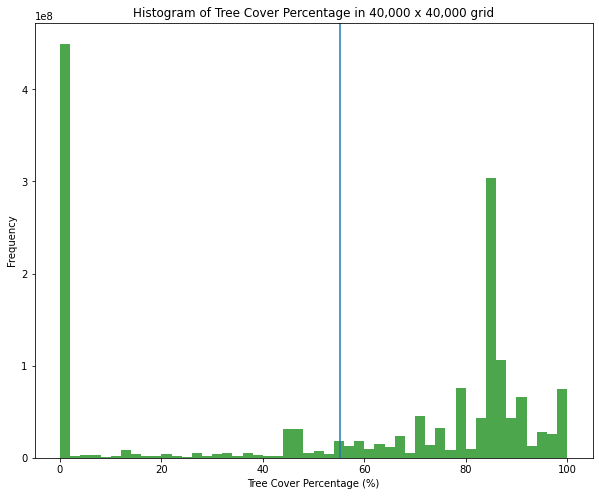

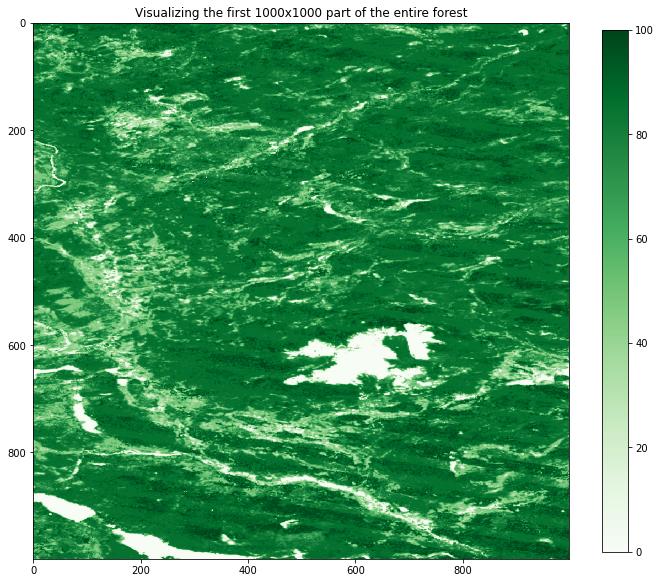

In [61]:
# Visualize the distribution of tree cover percentage
plt.figure(figsize=(10,8))
plt.hist(data_tile.flatten(), bins=50, color='green', alpha=0.7)
plt.xlabel('Tree Cover Percentage (%)')
plt.ylabel('Frequency')
plt.title('Histogram of Tree Cover Percentage in 40,000 x 40,000 grid')
plt.axvline(np.mean(data_tile.flatten()))
plt.show()

# Plot a 1000 x 1000 part of the whole data tile. 
plt.figure(figsize=(12, 12))
plt.imshow(data_tile[1:1000,1001:1999], cmap='Greens')
plt.colorbar(shrink=0.8)
plt.title('Visualizing the first 1000x1000 part of the entire forest')
plt.show()


Shape of the array: (100, 100)
Total number of cells: 10000
Minimum tree density: 0.0
Maximum tree density: 100.0
Shape of the array: (100, 100)
Mean tree density: 74.42%


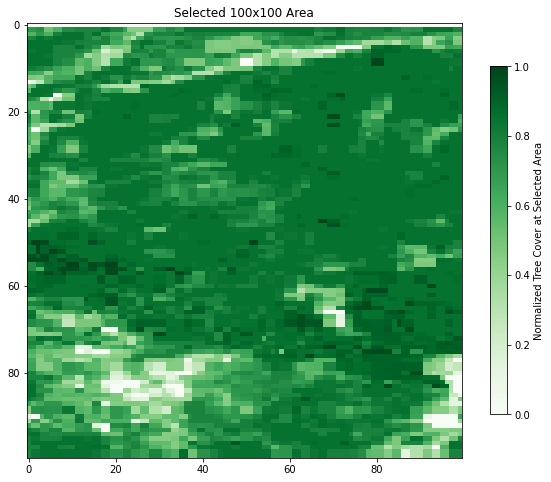

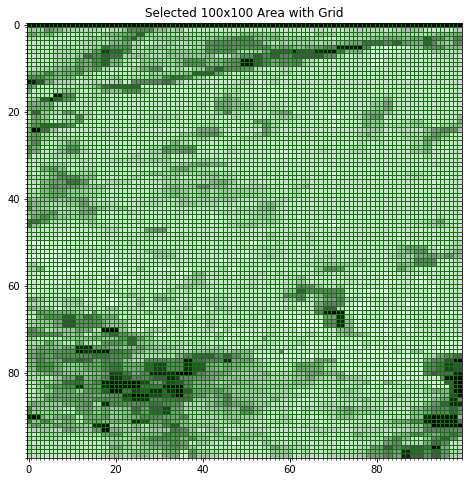

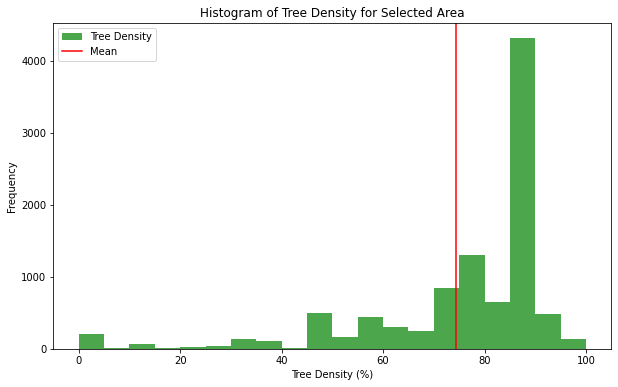

In [4]:
# Select 100x100 area from the data
# Normalize the data to be in the range [0, 1] for better analysis
selected_area = data_tile[1:101, 100:200] / 100.0
mean_tree_density = round(np.mean(selected_area.flatten())*100,2)

# Explore Array Attributes

# Shape and Size
print("Shape of the array:", selected_area.shape)
print("Total number of cells:", selected_area.size)

# Summary Statistics
print("Minimum tree density:", np.min(selected_area)*100)
print("Maximum tree density:", np.max(selected_area)*100)
print("Shape of the array:", selected_area.shape)
print(f"Mean tree density: {mean_tree_density}%")

# Visualize the selected area
plt.figure(figsize=(10, 8))
plt.imshow(selected_area, cmap='Greens')
plt.colorbar(shrink=0.8, label='Normalized Tree Cover at Selected Area')
plt.title('Selected 100x100 Area')
plt.show()

# Visualize the selected area with a grid

fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(selected_area, cmap='gray')
ax.set_title('Selected 100x100 Area with Grid')

# Add a grid
grid_color = 'green'
ax.set_xticks(np.arange(-0.5, 100, 1), minor=True)
ax.set_yticks(np.arange(-0.5, 100, 1), minor=True)
ax.grid(which="minor", color=grid_color, linestyle='-', linewidth=1)

plt.show()

# Visualize the histogram of tree cover percentage for the selected area with grid
plt.figure(figsize=(10,6))
plt.hist(np.array(selected_area.flatten())*100, bins=20, color='green', alpha=0.7, label='Tree Density')
plt.axvline(mean_tree_density, color='red', label = 'Mean')
plt.xlabel('Tree Density (%)')
plt.ylabel('Frequency')
plt.title('Histogram of Tree Density for Selected Area')
plt.legend()
plt.show()





In [19]:
class ForestFireModel:
    def __init__(self, wind_direction = 'W', wind_strength = 1,  grid_size=100, tree_density = selected_area):
        self.grid_size = grid_size
        self.wind_direction = wind_direction
        self.wind_strength = wind_strength
        self.initial_ignition_source = np.random.randint(0, self.grid_size), np.random.randint(0, self.grid_size)
        self.temperature = 25  # Example temperature in Celsius
        self.humidity = 0.5  # Example relative humidity
        self.tree_density = tree_density
        self.figure = None
        self.spread_probability = []
        self.initialize_grid()


    def initialize_grid(self):
        # Create a new grid with tree density and burning state
        self.forest = np.empty((self.grid_size, self.grid_size), dtype=[('tree_density', float), ('burning_state', int)])
        # Populate the grid with the tree density values
        self.forest['tree_density'] = self.tree_density
        # Set the burning state to 0
        self.forest['burning_state'] = 0

        # Set a fixed initial ignition source
        # Set a fixed initial ignition source
        i, j = self.initial_ignition_source
        if self.forest[i,j]['tree_density'] > 1:
          self.forest[i, j]['burning_state'] = 1
        else:
          self.forest[50,50]['burning_state'] = 1


    
    def wind_influence(self, i, j):
        wind_influence = np.zeros((self.grid_size, self.grid_size))
        wind_directions = {'N': (-1, 0), 'NE': (-1, 1), 'NW': (-1, -1), 'S': (1, 0), 'SE': (1, 1), 'SW': (1, -1), 'W': (0, -1), 'E': (0, 1)}

        for direction, (dy, dx) in wind_directions.items():
            #ni, nj = (i + dy) % self.grid_size, (j + dx) % self.grid_size  # Adjust for periodic boundary conditions
            ni, nj = i + dy, j + dx

            # Check if the new indices are within the grid bounds
            if 0 <= ni < self.grid_size and 0 <= nj < self.grid_size:


                # Assign wind influence probability based on wind direction and strength
                if direction == self.wind_direction:
                    wind_influence[ni, nj] = 1 * self.wind_strength
                elif direction in {'NE', 'NW'} and self.wind_direction == 'N':
                    wind_influence[ni, nj] = 0.7 * self.wind_strength
                elif direction in {'SE', 'SW'} and self.wind_direction == 'S':
                    wind_influence[ni, nj] = 0.7 * self.wind_strength
                elif direction in {'NE', 'SE'} and self.wind_direction == 'E':
                    wind_influence[ni, nj] = 0.7 * self.wind_strength
                elif direction in {'NW', 'SW'} and self.wind_direction == 'W':
                    wind_influence[ni, nj] = 0.7 * self.wind_strength
                else:
                    wind_influence[ni, nj] = 0.4 * self.wind_strength

        return wind_influence
    


    def simulate_step(self):
       
        # Create a copy of the current forest grid to avoid updating it in the middle of the simulation step
        new_forest = self.forest.copy()

        # Iterate over each cell in the grid
        for i in range(self.grid_size):
            for j in range(self.grid_size):
                #print(i,j)

                # If the cell is already on fire, calculate wind influence
                if new_forest[i, j]['burning_state'] == 1:
                    neighbors_on_fire = 0
                    total_neigbors = 0
                    #print(self.forest[i,j]['burning_state'])


                    #print(f'burning omg {i,j}')
                    wind_influence = self.wind_influence(i, j)

                        # Update neighboring cells based on wind influence
                    for ni in range(max(0, i - 1), min(i + 2, self.grid_size)):
                        for nj in range(max(0, j - 1), min(j + 2, self.grid_size)):
                            total_neigbors += 1
                            #print(f'checking {ni,nj}')
                            # Check if the neighbor is not the current cell and is not already burning
                            if (ni, nj) != (i, j) and new_forest[ni, nj]['burning_state'] == 0:
                                # Adjust the burning state of neighbors based on wind influence probabilities and tree density
                                if np.random.rand() < wind_influence[ni,nj] * self.forest[ni, nj]['tree_density']:
                                    new_forest[ni, nj]['burning_state'] = 1
                                    neighbors_on_fire += 1

                    self.spread_probability.append(neighbors_on_fire/total_neigbors)
                    
                    # The cell is charred and we continue with the next cell
                    new_forest[i, j]['burning_state'] = 2 



        self.forest = new_forest
        self.burnt_percentage = self.collect_percentage_burnt_data()
        #return self.forest
    
    def collect_fire_risk_data(self):
        fire_risk_data = np.zeros((self.grid_size, self.grid_size))

        for i in range(self.grid_size):
            for j in range(self.grid_size):
                if self.forest[i, j]['burning_state'] == 2:
                    fire_risk_data[i, j] = 1
                    for ni in range(max(0, i - 1), min(i + 2, self.grid_size)):
                        for nj in range(max(0, j - 1), min(j + 2, self.grid_size)):
                            if (ni, nj) != (i, j) and self.forest[ni, nj]['burning_state'] != 2:
                                fire_risk_data[ni, nj] = 1

        return fire_risk_data

    def collect_percentage_burnt_data(self):
        total_cells = self.grid_size ** 2
        percentage_burnt_data = np.sum(self.forest['burning_state'] == 2) / total_cells
        return percentage_burnt_data
    
    def run_simulations(self, num_simulations, steps):
        self.cumulative_fire_risk_data = np.zeros((self.grid_size, self.grid_size))
        self.cumulative_percentage_burnt_data = []


        for i in range(num_simulations):
            self.initialize_grid()
            for _ in range(steps):
                self.simulate_step()
            self.cumulative_fire_risk_data += self.collect_fire_risk_data()
            self.cumulative_percentage_burnt_data.append(self.collect_percentage_burnt_data())
            
        fire_risk_data = self.average_fire_risk_data(num_simulations)
        return fire_risk_data, self.cumulative_percentage_burnt_data

    def average_fire_risk_data(self, num_simulations):
        return self.cumulative_fire_risk_data / num_simulations
    
    def plot_with_fire_risk(self, fire_risk_data):
        # Create the original plot
        fig, ax = plt.subplots(figsize=(10, 8))
        ax.imshow(self.tree_density)
        ax.set_title('Area With Average Fire Risk (100x100)')

        # Add a grid
        ax.set_xticks(np.arange(-0.5, 100, 1), minor=True)
        ax.set_yticks(np.arange(-0.5, 100, 1), minor=True)
        ax.grid(which="minor", linestyle='-', linewidth=0.2)

        # Overlay fire risk data
        cmap = plt.cm.afmhot_r
        overlay_plot = ax.imshow(fire_risk_data, cmap=cmap, alpha=1, extent=(0, 100, 0, 100), origin='lower', vmin=0, vmax=1)

        # Add colorbar for the fire risk data
        cbar = plt.colorbar(overlay_plot)
        cbar.set_label('Fire Risk')

        plt.show()
        

class ForestFireAnimation:
    def __init__(self, model, total_frames, steps_per_frame=1, interval=100):
        self.model = model
        self.total_frames = total_frames
        self.steps_per_frame = steps_per_frame
        self.interval = interval
        self.figure, self.ax = plt.subplots(figsize=(10,8))
        self.burning_plot = None

    def initialize_animation(self):
        # Define custom colormap for burning states: 0 (green), 1 (orange), 2 (black)
        cmap = plt.cm.colors.ListedColormap(['darkgreen', 'orange', 'black'])

        # Explicitly convert forest to a numeric data type (e.g., float)
        forest_numeric = self.model.forest['burning_state'].astype(float)
        self.burning_plot = self.ax.imshow(forest_numeric, cmap=cmap, interpolation='nearest', vmin=0, vmax=2)
        self.ax.set_title(f'Forest Fire Simulation: Wind Direction: {self.model.wind_direction}, Wind Strength: {self.model.wind_strength*100}%')
        self.figure.tight_layout()
        self.time_step_text = self.ax.text(0.02, 0.95, '', transform=self.ax.transAxes, color='white', fontsize=12)
        self.burnt_percentage_count = self.ax.text(0.02, 0.90, '', transform=self.ax.transAxes, color='white', fontsize=12)

        # Add legend
        legend_labels = ['Healthy', 'Burning', 'Charred']
        self.ax.legend(handles=[plt.Rectangle((0, 0), 1, 1, color=cmap(i)) for i in range(3)], labels=legend_labels, loc='upper right')


        return [self.burning_plot, self.time_step_text]
       

    def update_animation(self, frame_number):
        for _ in range(self.steps_per_frame):
            self.model.simulate_step()  # Simulate one step of the forest fire

        # Update the burning plot
        self.burning_plot.set_array(self.model.forest['burning_state'])
         # Update the time step text
        self.time_step_text.set_text(f'Time Step: {(frame_number) * self.steps_per_frame}')
        self.burnt_percentage_count.set_text(f'Percentage Charred: {round(self.model.burnt_percentage*100,2)}')
        return [self.burning_plot, self.time_step_text]

    def create_animation(self):
        self.model.initialize_grid()  # Initialize the forest grid
        anim = FuncAnimation(
            self.figure, self.update_animation, init_func=self.initialize_animation,
            frames=self.total_frames, interval=self.interval, repeat=False
        )
        return HTML(anim.to_jshtml())

In [26]:
def visualize_tree_density_fire_risk_relationship(model, fire_risk_data):
        
        # # Get tree density and fire risk data
        tree_density = model.tree_density.flatten()

        
        # Adjust the fire risk data accordingly
        fire_risk_data = fire_risk_data.flatten()

        # Fit a linear trend line (1st-degree polynomial) and set intercept to zero
        coefficients = np.polyfit(tree_density, fire_risk_data, 1)
        #coefficients[1] = 0  # Force intercept to be zero
        poly_fit = np.poly1d(coefficients)

        # Create scatter plot
        plt.figure(figsize=(10,8))
        plt.scatter(tree_density, fire_risk_data, label='Data Points', color='red', alpha=0.7)

        # Plot the trend line
        plt.plot(tree_density, poly_fit(tree_density), color='black', label='Trend Line')
        plt.title('Scatter Plot of Tree Density and Fire Risk')

        # Add labels and legend
        plt.xlabel('Tree Density')
        plt.ylabel('Fire Risk')
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

        # Show the plot
        plt.show()
        print(f'The equation fitting the scatter plot: {poly_fit}')

def visualize_percentage_burnt_histogram(cumulative_percentage_burnt_data):
        cumulative_percentage_burnt_data = np.array(cumulative_percentage_burnt_data) * 100

        # Calculate mean and confidence interval
        mean_percentage_burnt = np.mean(cumulative_percentage_burnt_data, axis=0)
        confidence_interval = stats.t.interval(
            0.95, len(cumulative_percentage_burnt_data) - 1,
            loc=np.mean(cumulative_percentage_burnt_data, axis=0),
            scale=stats.sem(cumulative_percentage_burnt_data, axis=0)
        )


        print(f'The 95% confidence interval of percentage burnt cells is {round(confidence_interval[0],2)}% and {round(confidence_interval[1],2)}%')
        print(f'The mean percentage burnt is {mean_percentage_burnt}')

        # Plot histogram
        plt.figure(figsize=(10, 6))
        plt.hist(cumulative_percentage_burnt_data, density=False, color='maroon', label='Simulation Data')

        # Plot mean and confidence interval
        plt.axvline(mean_percentage_burnt.mean(), color='black', linestyle='dashed', linewidth=2, label='Mean')
        plt.axvline(confidence_interval[0], color='orange', label='95% CI', linestyle='dashed')
        plt.axvline(confidence_interval[1], color='orange', linestyle='dashed')

        plt.title('Percentage Burnt Histogram with 95% Confidence Interval')
        plt.xlabel('Percentage Burnt (%)')
        plt.ylabel('Frequency')
        plt.legend()
        plt.show()
                

In [7]:
class ComparativeStudy:
    def __init__(self, parameter_sets):
        self.parameter_sets = parameter_sets
        self.results = []

    def run_simulation(self, num_simulations=100, steps=100):
        for params in self.parameter_sets:
            forest_model = ForestFireModel(**params)
            fire_risk_data, percentage_burnt_data = forest_model.run_simulations(num_simulations=num_simulations, steps=steps)
            percentage_burnt_data = np.array(percentage_burnt_data)*100
            self.results.append({
                'parameters': params,
                'fire_risk_data': fire_risk_data,
                'percentage_burnt_data': percentage_burnt_data
            })

def visualize_results(results):
    for result in results:
        wind_strength = result['parameters']['wind_strength']
        direction = result['parameters']['wind_direction']
        data = result['percentage_burnt_data']
        confidence_interval = stats.t.interval(
            0.95, len(data) - 1,
            loc=np.mean(data, axis=0),
            scale=stats.sem(data, axis=0)
        )
        
        # Visualize fire risk data
        plt.figure(figsize=(10, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(result['fire_risk_data'], cmap='hot_r', origin='lower', extent=(0, 100, 0, 100))
        plt.title(f'Fire Risk with Wind Strength = {wind_strength}')
        plt.colorbar(label='Fire Risk')

        # Visualize percentage burnt data
        plt.subplot(1, 2, 2)
        plt.hist(data, color='red', alpha=1, label='Simulated data')
        plt.axvline(np.mean(data),color='black', label='Mean', linestyle='dashed')
        plt.axvline(confidence_interval[0], color='yellow', label='Confidence Interval', linestyle ='dashed')
        plt.axvline(confidence_interval[1], color='yellow')
        plt.title(f'Percentage Burnt for Model with Wind Strength = {wind_strength}')
        plt.xlabel('Percentage Burnt')
        plt.ylabel('Frequency')

        plt.tight_layout()
        plt.legend()
        plt.show()

if __name__ == "__main__":
    # Define different parameter sets for the comparative study
    parameter_sets = [
        {'wind_direction': 'N', 'wind_strength': 1, 'tree_density': selected_area},
        {'wind_direction': 'N', 'wind_strength': 0.8, 'tree_density': selected_area},
        {'wind_direction': 'N', 'wind_strength': 0.6, 'tree_density': selected_area},
        {'wind_direction': 'N', 'wind_strength': 0.4, 'tree_density': selected_area},
        {'wind_direction': 'N', 'wind_strength': 0.2, 'tree_density': selected_area},
    ]




In [44]:
def theoretical_spread(wind_strength, wind_influence, tree_density):
    return wind_strength*wind_influence*np.mean(tree_density)

In [8]:
# Create a Comparative Study instance
study = ComparativeStudy(parameter_sets)

# Run the simulation for each parameter set
study.run_simulation(num_simulations=100, steps=100)


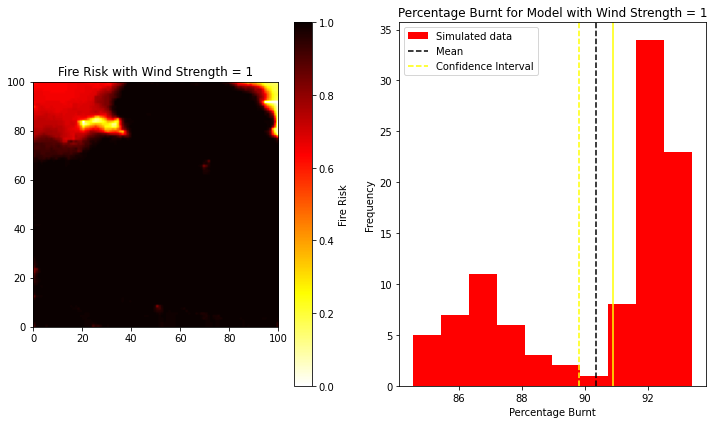

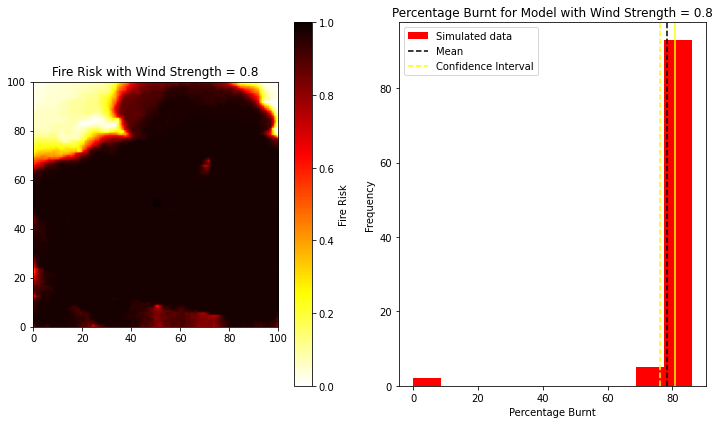

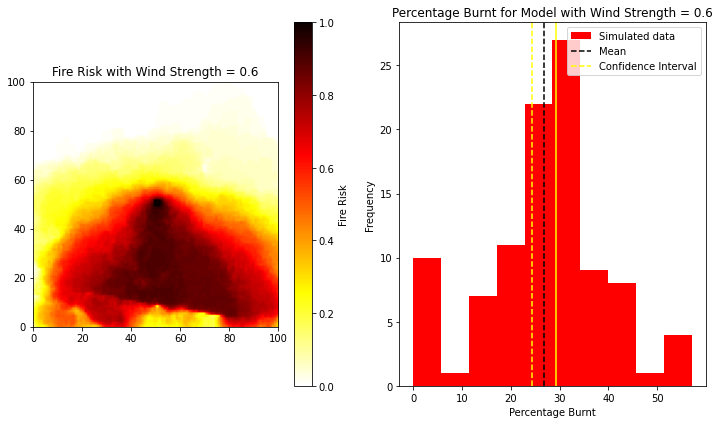

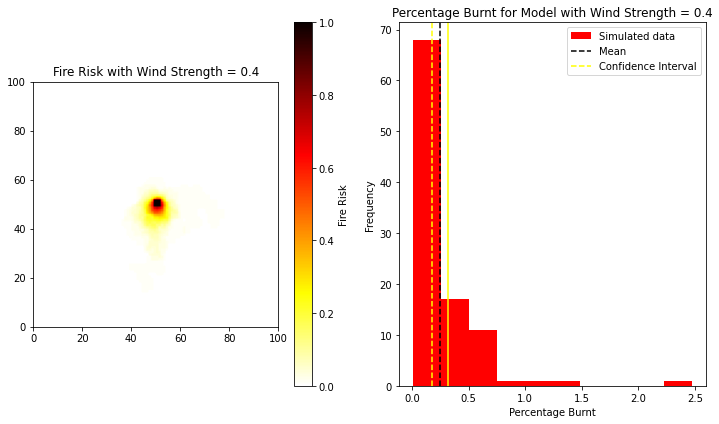

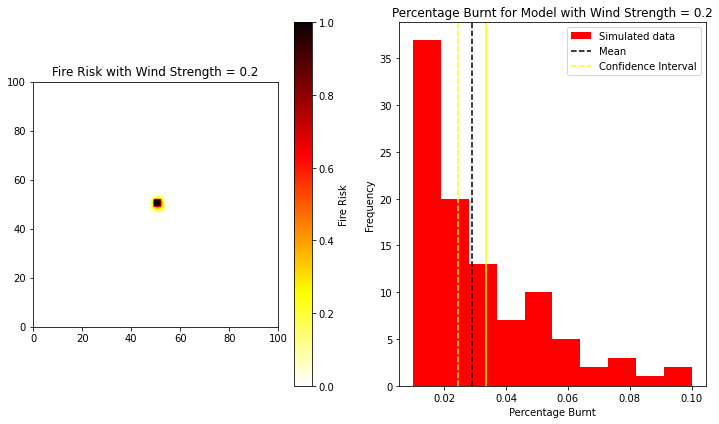

In [9]:
visualize_results(study.results)

In [45]:
num_simulations = 100
steps = 100
total_frames = 100
wind_influence = 0.7*0.4

In [20]:
#Initialize three model instances
amazon = ForestFireModel()
redwood = ForestFireModel(wind_direction='NE',wind_strength=0.5)
primorye = ForestFireModel(wind_direction='S', wind_strength=0.1)

In [40]:
congo = ForestFireModel(wind_direction='N', wind_strength=0.61)

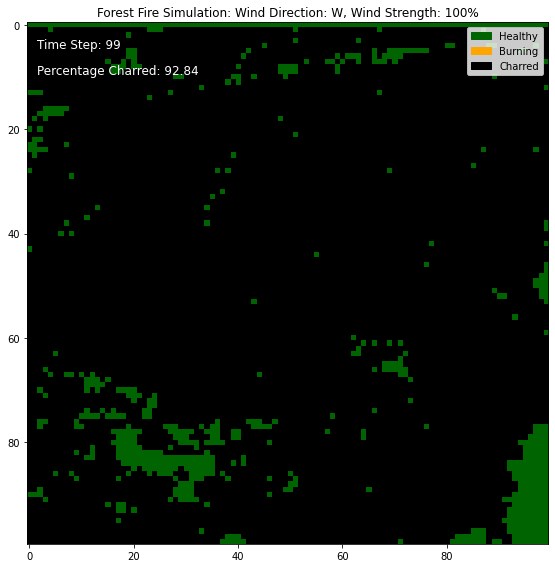

In [21]:
amazon_animation = ForestFireAnimation(model=amazon, total_frames=total_frames)
amazon_animation.create_animation()


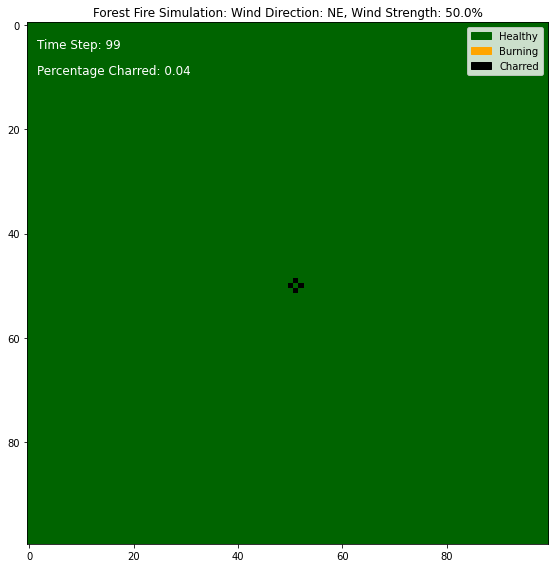

In [22]:
redwood_animation = ForestFireAnimation(model=redwood, total_frames=total_frames)
redwood_animation.create_animation()

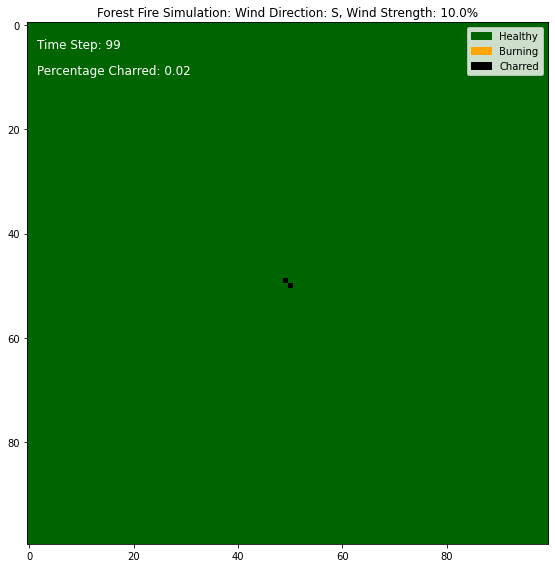

In [38]:
primorye_animation = ForestFireAnimation(primorye,total_frames)
primorye_animation.create_animation()

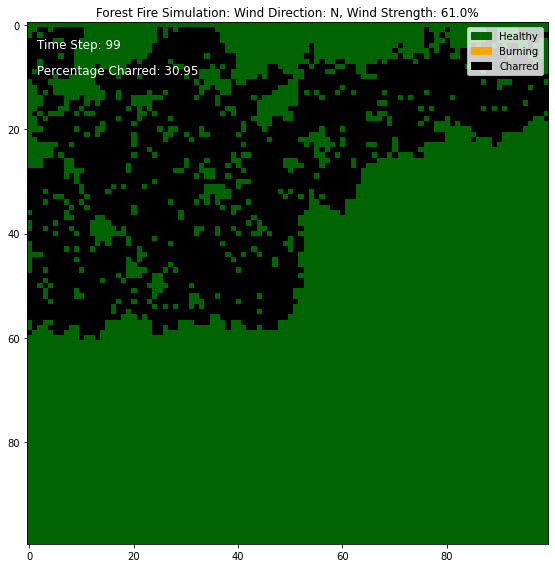

In [41]:
congo_animation = ForestFireAnimation(congo,total_frames)
congo_animation.create_animation()

In [24]:
amazon_fire_risk, amazon_burnt_data = amazon.run_simulations(num_simulations,steps)

In [31]:
redwood_fire_risk, redwood_burnt_data = redwood.run_simulations(num_simulations,steps)

In [36]:
primorye_fire_risk, primorye_burnt_data = primorye.run_simulations(num_simulations,steps)

In [42]:
congo_fire_risk, congo_burnt_data = congo.run_simulations(num_simulations,steps)

In [46]:
amazon_theory = theoretical_spread(amazon.wind_strength,wind_influence,selected_area)

Wind Direction: W, Wind Strength: 100%


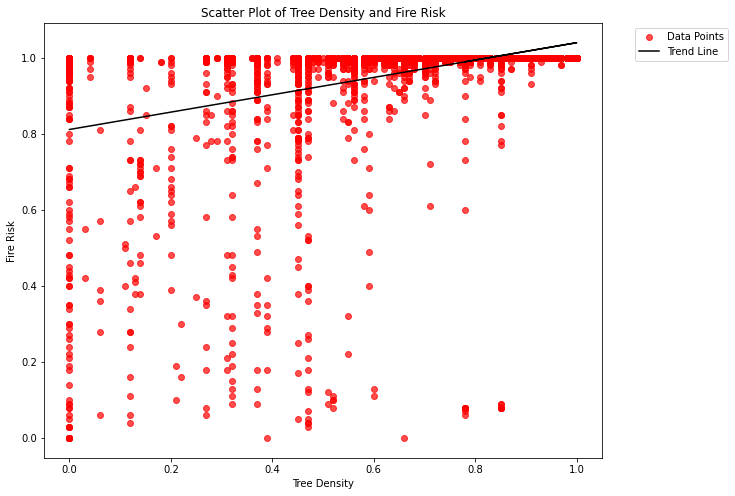

The equation fitting the scatter plot:  
0.2282 x + 0.8114


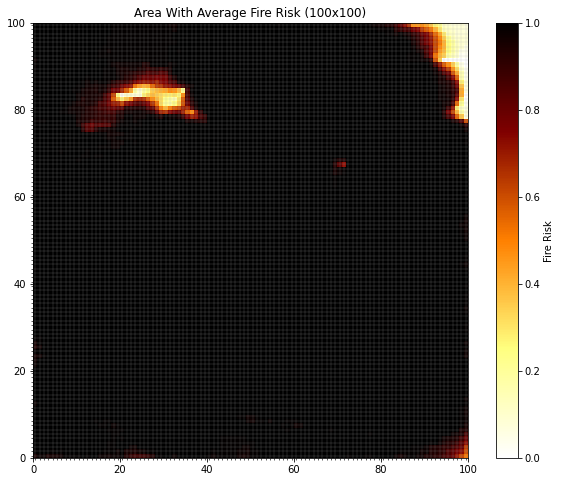

The 95% confidence interval of percentage burnt cells is 92.26% and 92.45%
The mean percentage burnt is 92.35410000000002


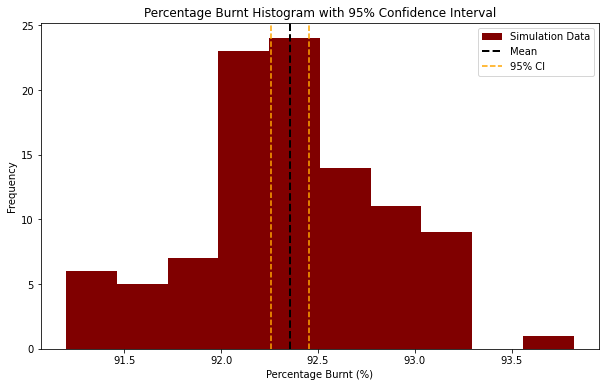

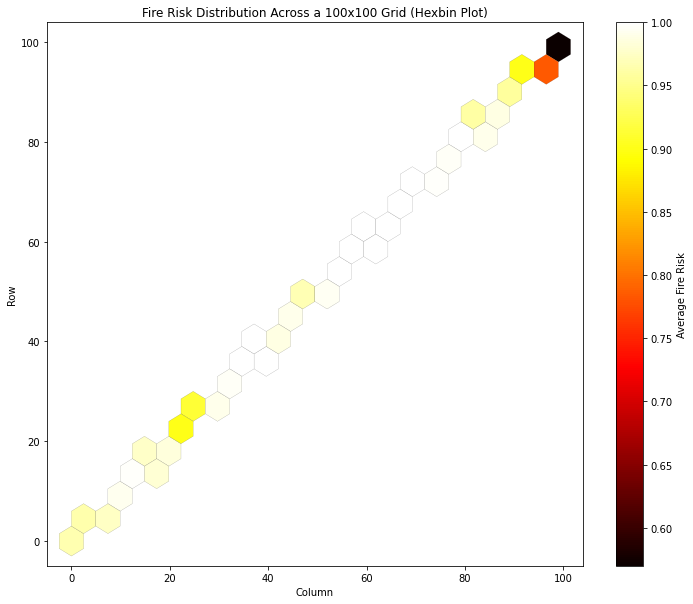

In [34]:
# Test Case 1 Complete Data Visualizations
print(f'Wind Direction: {amazon.wind_direction}, Wind Strength: {amazon.wind_strength*100}%')

# Scatter Plot
visualize_tree_density_fire_risk_relationship(amazon,amazon_fire_risk)

# Fire Risk Overlay
amazon.plot_with_fire_risk(amazon_fire_risk)

# % Burnt Histogram
visualize_percentage_burnt_histogram(amazon_burnt_data)

# Hexbin plot
plt.figure(figsize=(12, 10))
plt.hexbin(range(100), range(100), C=amazon_fire_risk.flatten(), gridsize=20, cmap='hot', edgecolors='k', linewidth=0.1)
plt.colorbar(label='Average Fire Risk')
plt.title('Fire Risk Distribution Across a 100x100 Grid (Hexbin Plot)')
plt.xlabel('Column')
plt.ylabel('Row')
plt.show()


In [55]:
redwood_theory = theoretical_spread(redwood.wind_strength,wind_influence, selected_area)

Wind Direction: NE, Wind Strength: 50.0%


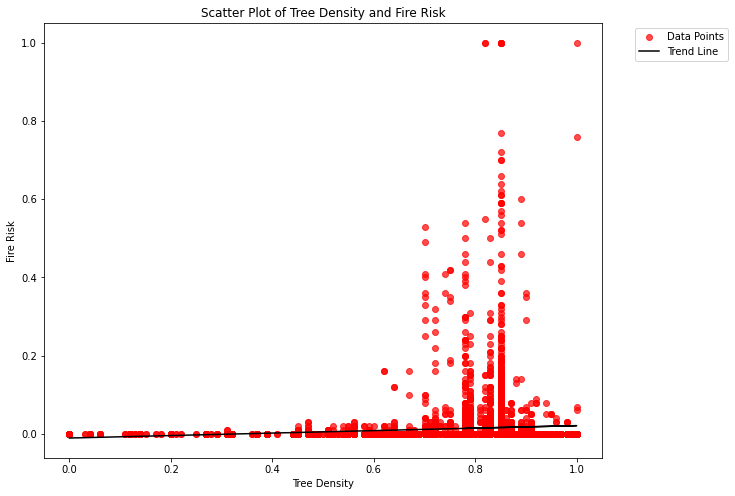

The equation fitting the scatter plot:  
0.03164 x - 0.01056


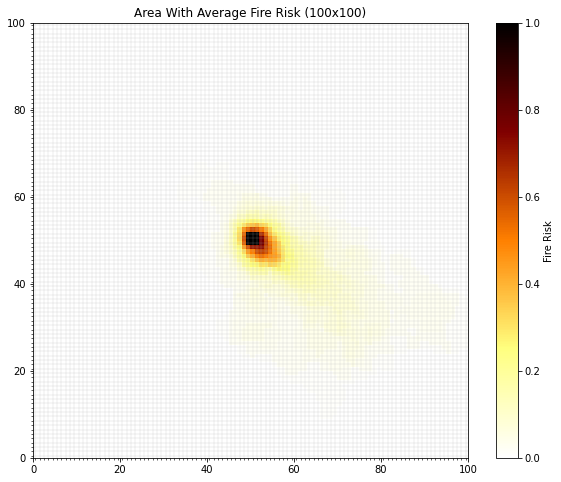

The 95% confidence interval of percentage burnt cells is 0.41% and 0.84%
The mean percentage burnt is 0.6267999999999999


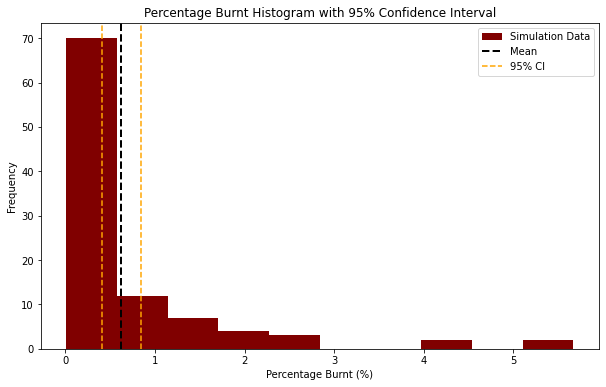

95% Confidence Interval: (0.10847999498275512, 0.11254627092572039). Empirical Mean:0.11051313295423776. Theoretical Mean: 0.10418435999999998


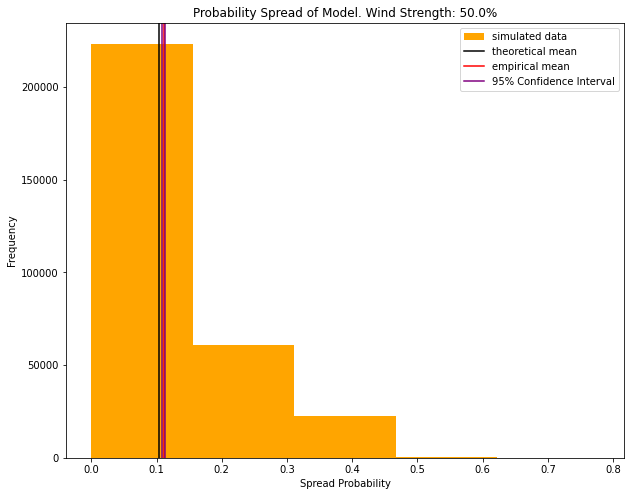

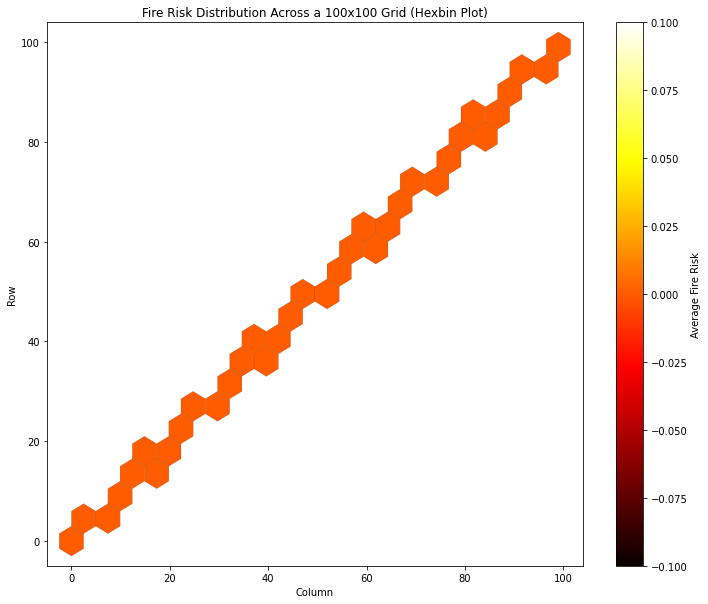

In [57]:
# Test Case 2 Complete Data Visualizations
print(f'Wind Direction: {redwood.wind_direction}, Wind Strength: {redwood.wind_strength*100}%')

# Scatter Plot
visualize_tree_density_fire_risk_relationship(redwood,redwood_fire_risk)

# Fire Risk Overlay
redwood.plot_with_fire_risk(redwood_fire_risk)

# % Burnt Histogram
visualize_percentage_burnt_histogram(redwood_burnt_data)


# Spread probability
plt.figure(figsize=(10,8))
plt.hist(congo.spread_probability, color='orange', label ='simulated data', bins=5, density=False)
plt.axvline(redwood_theory, color='black', label = 'theoretical mean')
plt.axvline(np.mean(congo.spread_probability), color='red', label ='empirical mean')
confidence_interval = stats.t.interval(
            0.95, len(redwood.spread_probability) - 1,
            loc=np.mean(redwood.spread_probability, axis=0),
            scale=stats.sem(redwood.spread_probability, axis=0)
        )
plt.axvline(confidence_interval[1], color='purple', label='95% Confidence Interval')
plt.axvline(confidence_interval[0], color ='purple')
plt.xlabel('Spread Probability')
plt.ylabel('Frequency')
plt.legend()
plt.title(f'Probability Spread of Model. Wind Strength: {redwood.wind_strength*100}%')
print(f'95% Confidence Interval: {confidence_interval}. Empirical Mean:{np.mean(redwood.spread_probability)}. Theoretical Mean: {redwood_theory}')

# Hexbin plot
plt.figure(figsize=(12, 10))
plt.hexbin(range(100), range(100), C=redwood_fire_risk.flatten(), gridsize=20, cmap='hot', edgecolors='k', linewidth=0.1)
plt.colorbar(label='Average Fire Risk')
plt.title('Fire Risk Distribution Across a 100x100 Grid (Hexbin Plot)')
plt.xlabel('Column')
plt.ylabel('Row')
plt.show()


In [47]:
congo_theory = theoretical_spread(congo.wind_strength, wind_influence,selected_area)

Wind Direction: S, Wind Strength: 10.0%


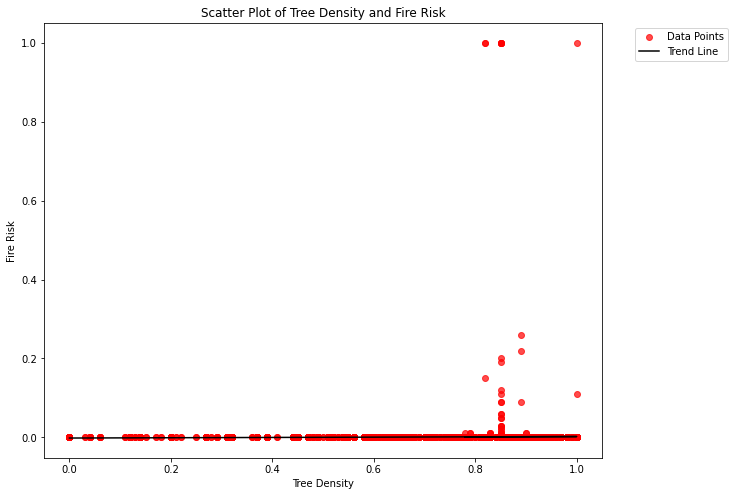

The equation fitting the scatter plot:  
0.003721 x - 0.001655


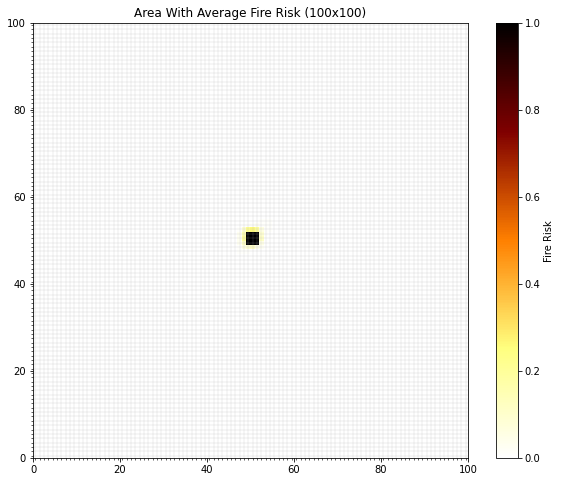

The 95% confidence interval of percentage burnt cells is 0.01% and 0.02%
The mean percentage burnt is 0.015899999999999997


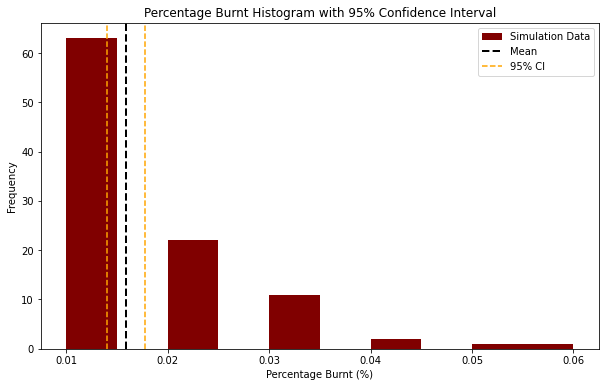

95% Confidence Interval: (0.11095953993571234, 0.11171749664301275). Empirical Mean:0.11133851828936255. Theoretical Mean: 0.12710491919999997


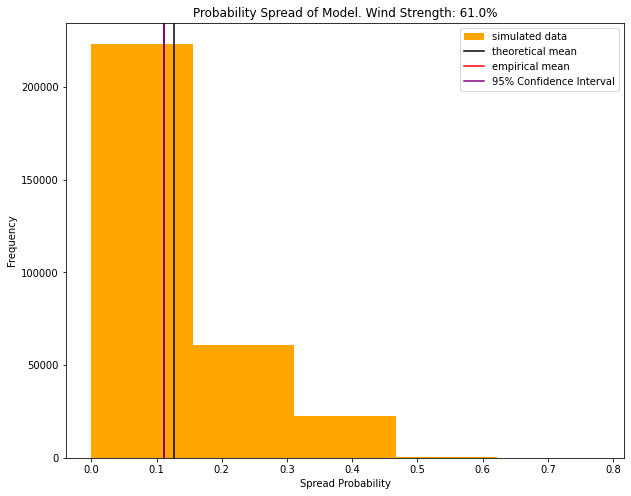

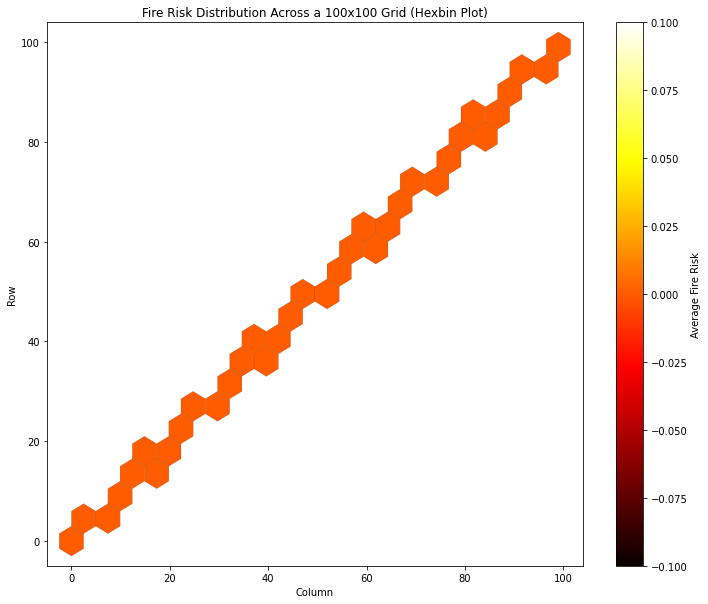

In [58]:
# Test Case 3 Complete Data Visualizations
print(f'Wind Direction: {primorye.wind_direction}, Wind Strength: {primorye.wind_strength*100}%')

# Scatter Plot
visualize_tree_density_fire_risk_relationship(primorye,primorye_fire_risk)

# Fire Risk Overlay
primorye.plot_with_fire_risk(primorye_fire_risk)

# % Burnt Histogram
visualize_percentage_burnt_histogram(primorye_burnt_data)

# Spread probability
plt.figure(figsize=(10,8))
plt.hist(congo.spread_probability, color='orange', label ='simulated data', bins=5, density=False)
plt.axvline(congo_theory, color='black', label = 'theoretical mean')
plt.axvline(np.mean(congo.spread_probability), color='red', label ='empirical mean')
confidence_interval = stats.t.interval(
            0.95, len(congo.spread_probability) - 1,
            loc=np.mean(congo.spread_probability, axis=0),
            scale=stats.sem(congo.spread_probability, axis=0)
        )
plt.axvline(confidence_interval[1], color='purple', label='95% Confidence Interval')
plt.axvline(confidence_interval[0], color ='purple')
plt.xlabel('Spread Probability')
plt.ylabel('Frequency')
plt.legend()
plt.title(f'Probability Spread of Model. Wind Strength: {congo.wind_strength*100}%')
print(f'95% Confidence Interval: {confidence_interval}. Empirical Mean:{np.mean(congo.spread_probability)}. Theoretical Mean: {congo_theory}')

# Hexbin plot
plt.figure(figsize=(12, 10))
plt.hexbin(range(100), range(100), C=primorye_fire_risk.flatten(), gridsize=20, cmap='hot', edgecolors='k', linewidth=0.1)
plt.colorbar(label='Average Fire Risk')
plt.title('Fire Risk Distribution Across a 100x100 Grid (Hexbin Plot)')
plt.xlabel('Column')
plt.ylabel('Row')
plt.show()

Wind Direction: N, Wind Strength: 61.0%


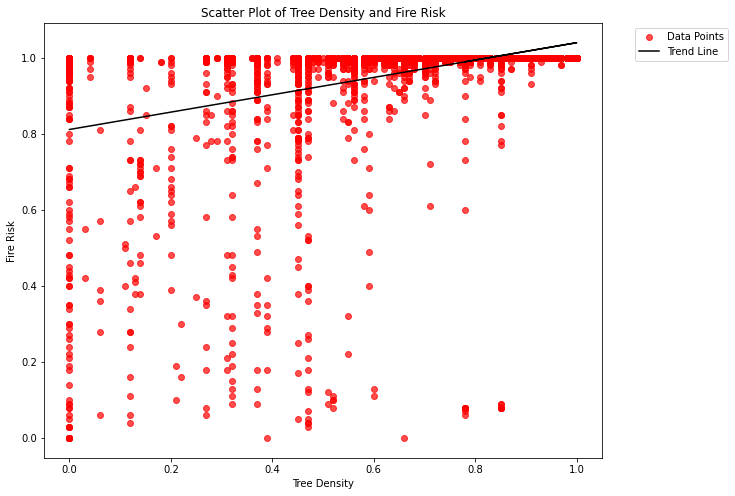

The equation fitting the scatter plot:  
0.2282 x + 0.8114


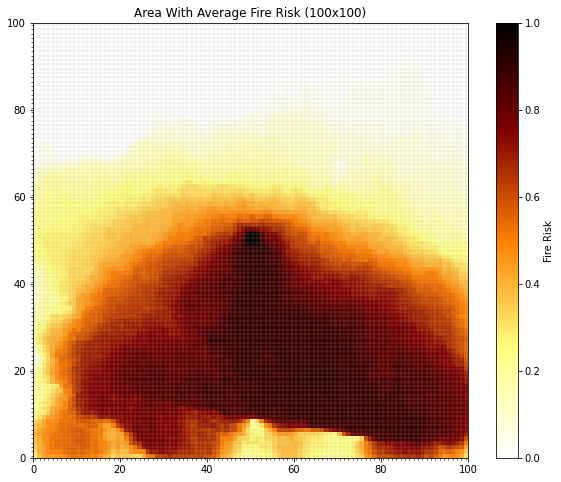

The 95% confidence interval of percentage burnt cells is 27.81% and 32.99%
The mean percentage burnt is 30.398999999999997


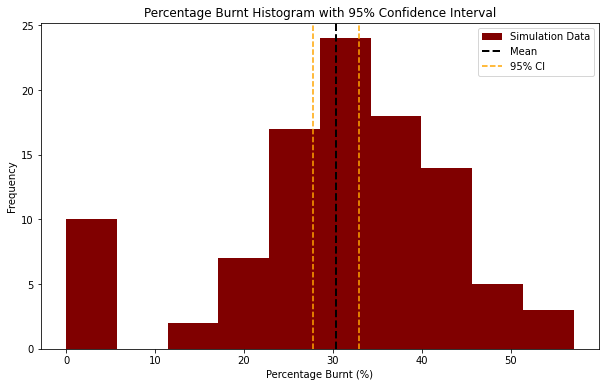

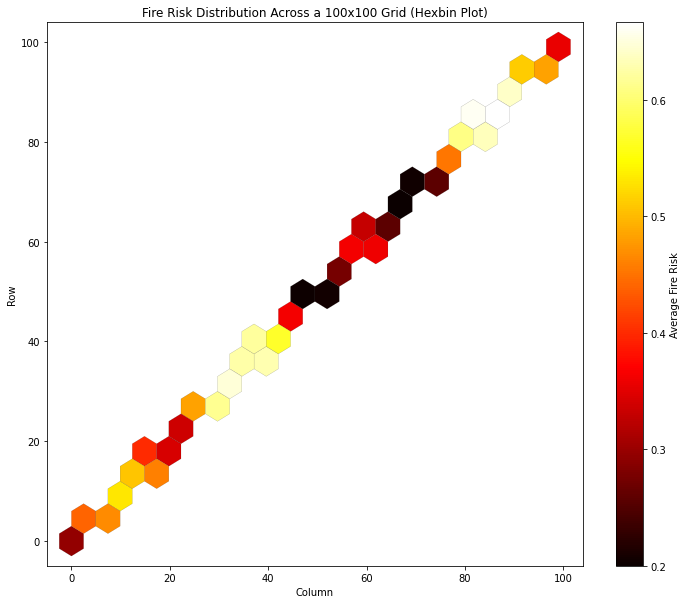

In [43]:
# Test Case 4 Complete Data Visualizations
print(f'Wind Direction: {congo.wind_direction}, Wind Strength: {congo.wind_strength*100}%')

# Scatter Plot
visualize_tree_density_fire_risk_relationship(congo,amazon_fire_risk)

# Fire Risk Overlay
amazon.plot_with_fire_risk(congo_fire_risk)

# % Burnt Histogram
visualize_percentage_burnt_histogram(congo_burnt_data)

# Hexbin plot
plt.figure(figsize=(12, 10))
plt.hexbin(range(100), range(100), C=congo_fire_risk.flatten(), gridsize=20, cmap='hot', edgecolors='k', linewidth=0.1)
plt.colorbar(label='Average Fire Risk')
plt.title('Fire Risk Distribution Across a 100x100 Grid (Hexbin Plot)')
plt.xlabel('Column')
plt.ylabel('Row')
plt.show()


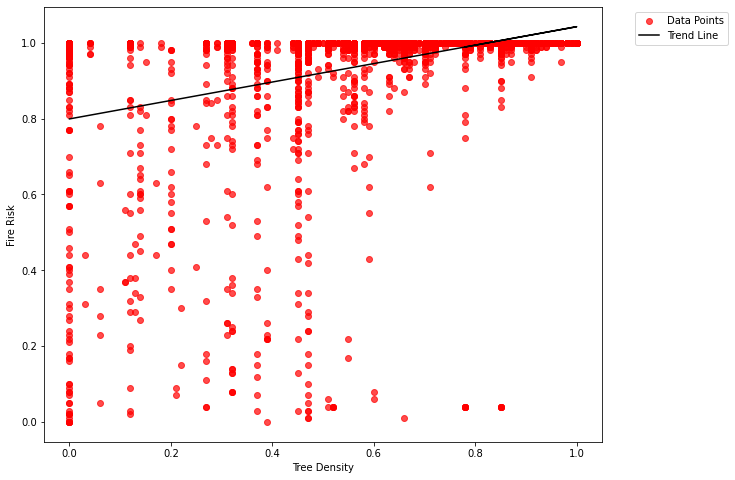

 
0.2431 x + 0.7991


In [44]:
visualize_tree_density_fire_risk_relationship(forest_model,average_fire_risk_data)

The 95% confidence interval of percentage burnt cells is 92.18% and 92.38%


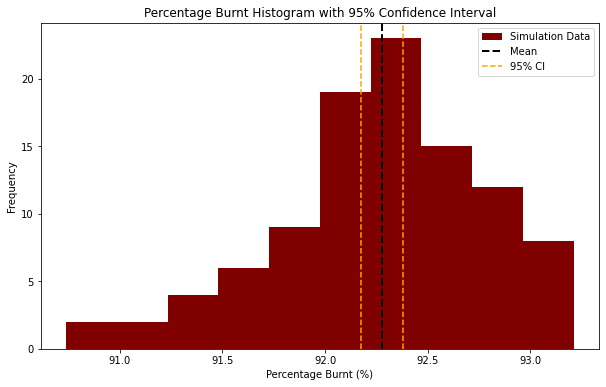

In [45]:
visualize_percentage_burnt_histogram(percentage_burnt_data)

In [46]:
test_1 = ForestFireModel(wind_direction = 'S', wind_strength = 1,  grid_size=100, tree_density = selected_area)
test1_fire_risk, test1_percentage_burnt = test_1.run_simulations(100,100)

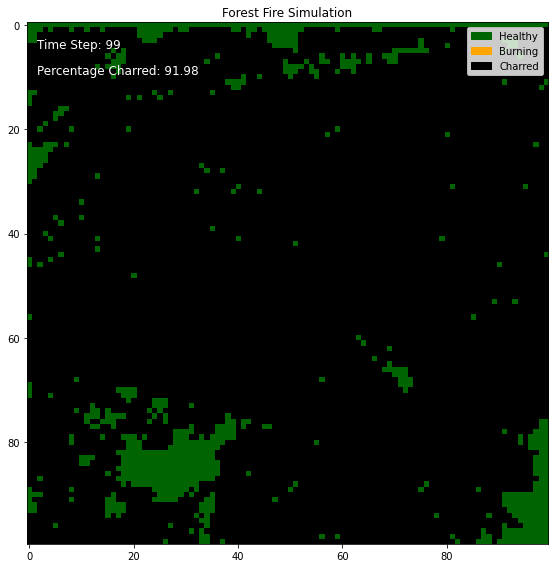

In [65]:
test = ForestFireModel(wind_direction = 'S', wind_strength = 1,  grid_size=100, tree_density = selected_area)
forest1_animation = ForestFireAnimation(model=test, total_frames=100)
forest1_animation.create_animation()

The 95% confidence interval of percentage burnt cells is 91.41% and 91.8%


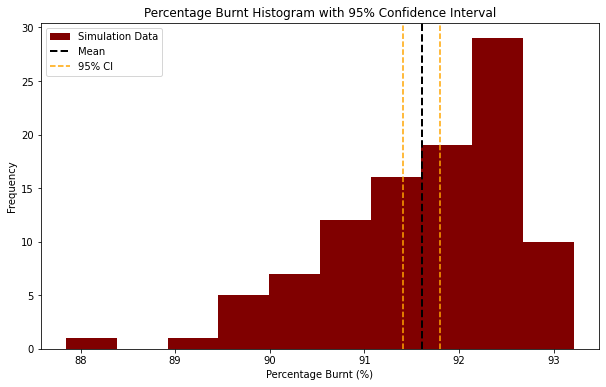

In [47]:
visualize_percentage_burnt_histogram(test1_percentage_burnt)

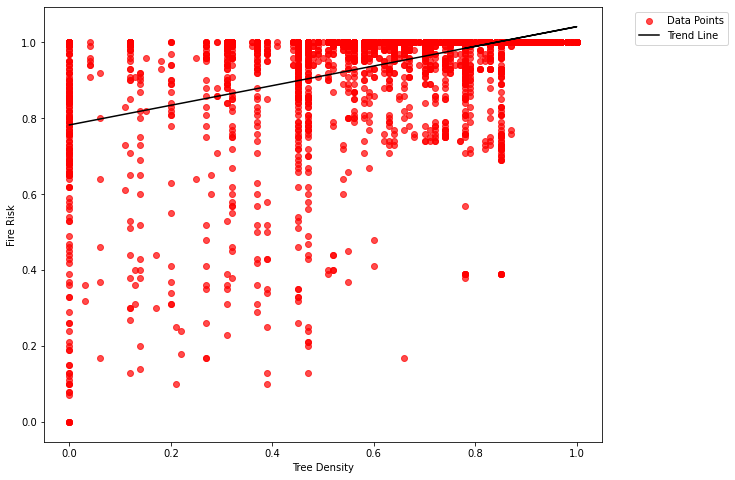

 
0.2588 x + 0.7828


In [48]:
visualize_tree_density_fire_risk_relationship(forest_model,test1_fire_risk)

In [70]:
test_2 = ForestFireModel(wind_direction = 'N', wind_strength = 1)
test2_fire_risk_data, test2_percentage_burnt= test_2.run_simulations(100,100)

The 95% confidence interval of percentage burnt cells is 89.73% and 90.87%


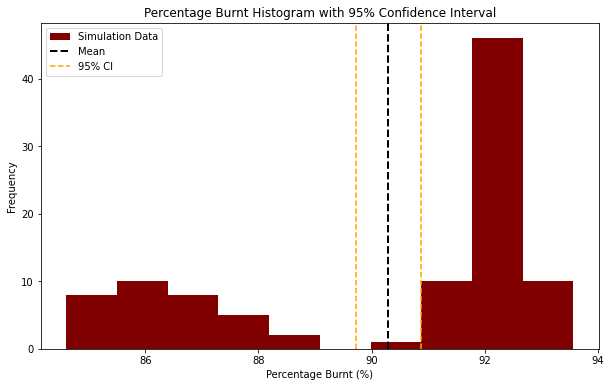

In [71]:
visualize_percentage_burnt_histogram(test2_percentage_burnt)

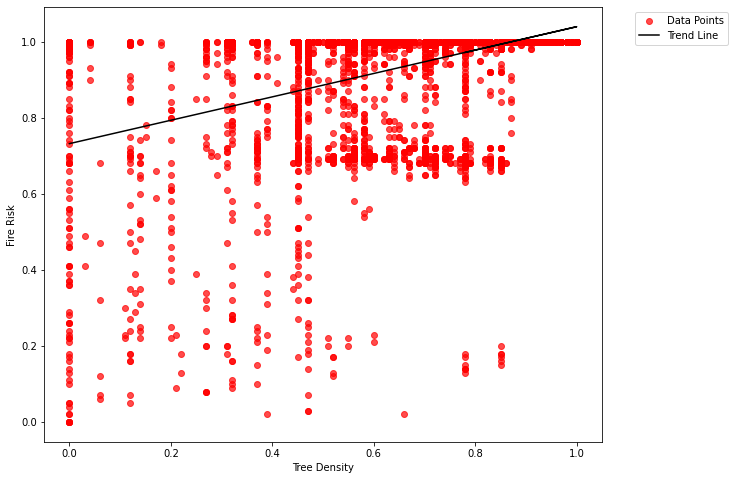

 
0.3073 x + 0.7316


In [424]:
visualize_tree_density_fire_risk_relationship(test_2,test2_fire_risk_data)

Test 1:


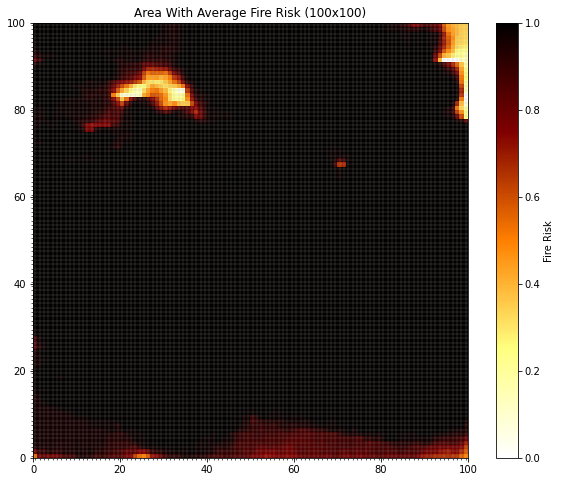

In [443]:
print('Test 1:')
test_1.plot_with_fire_risk(test1_fire_risk)


Test 2


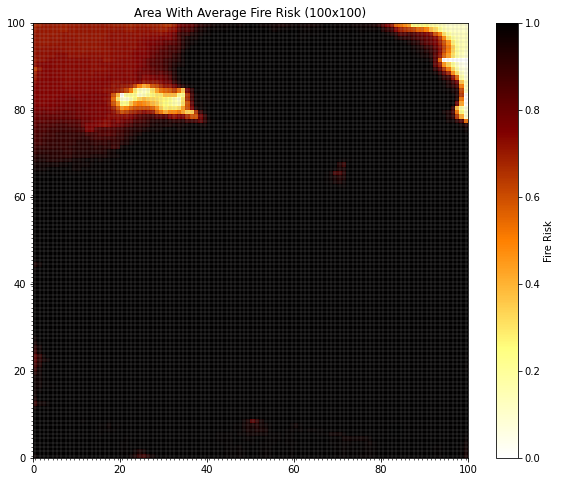

In [444]:
print('Test 2')
test_2.plot_with_fire_risk(test2_fire_risk_data)

wind_direction = S, wind_strength = 1


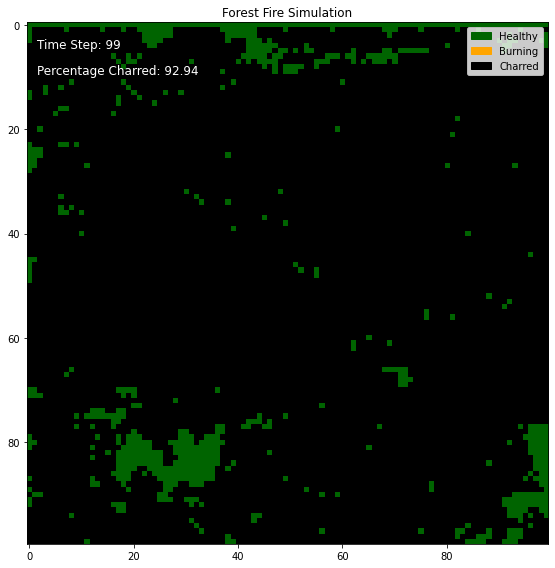

In [442]:
print('wind_direction = S, wind_strength = 1')
forest1_animation = ForestFireAnimation(model=test_1, total_frames=100)
forest1_animation.create_animation()

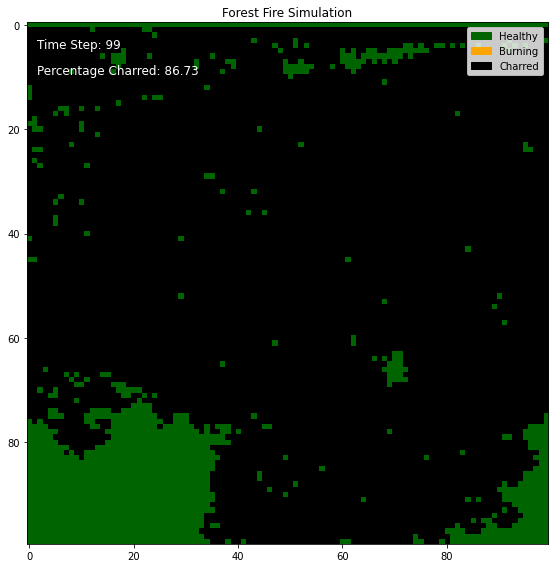

In [72]:
forest2_animation = ForestFireAnimation(model=test_2, total_frames=100)
forest2_animation.create_animation()

In [73]:
print(f'Wind direction: {test_2.wind_direction}, Burnt Percentage: {test_2.burnt_percentage*100}')
print(f'Wind direction: {test_1.wind_direction}, Burnt Percentage: {test_1.burnt_percentage*100}')
print(f'Wind direction: {forest_model.wind_direction}, Burnt Percentage: {forest_model.burnt_percentage*100}')

Wind direction: N, Burnt Percentage: 86.72999999999999
Wind direction: S, Burnt Percentage: 92.47
Wind direction: W, Burnt Percentage: 92.39


In [83]:
def analyze_wind_strength(model, directions, strength_values, num_simulations=100, steps_per_simulation=100):
    # Set up the plot
    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_xlabel('Wind Strength')
    ax.set_ylabel('Mean Charred Forest (%)')

    for direction in directions:
        # Store results for each direction
        direction_mean_percentages = []

        for strength in strength_values:
            # Store results for each simulation
            burnt_percentages = []

            for _ in range(num_simulations):
                # Reset the model for each simulation
                model.wind_direction = direction
                model.wind_strength = strength
                model.initialize_grid()

                # Run the simulation
                for _ in range(steps_per_simulation):
                    model.simulate_step()

                # Collect burnt percentage data
                burnt_percentages.append(model.collect_percentage_burnt_data())

            # Calculate the mean burnt percentage for the current wind strength
            mean_percentage = np.mean(burnt_percentages)
            mean_percentage = np.array(mean_percentage*100)
            direction_mean_percentages.append(mean_percentage)

        # Plot the line for the current wind direction
        ax.plot(strength_values, direction_mean_percentages, marker='o', linestyle='-', label=f'Direction: {direction}')

    # Add legend
    ax.legend()
    
    # Adjust layout and show the plot
    plt.tight_layout()
    plt.title('Wind Strength vs. Mean Charred Percentage of Forest For Different Wind Directions')
    plt.show()




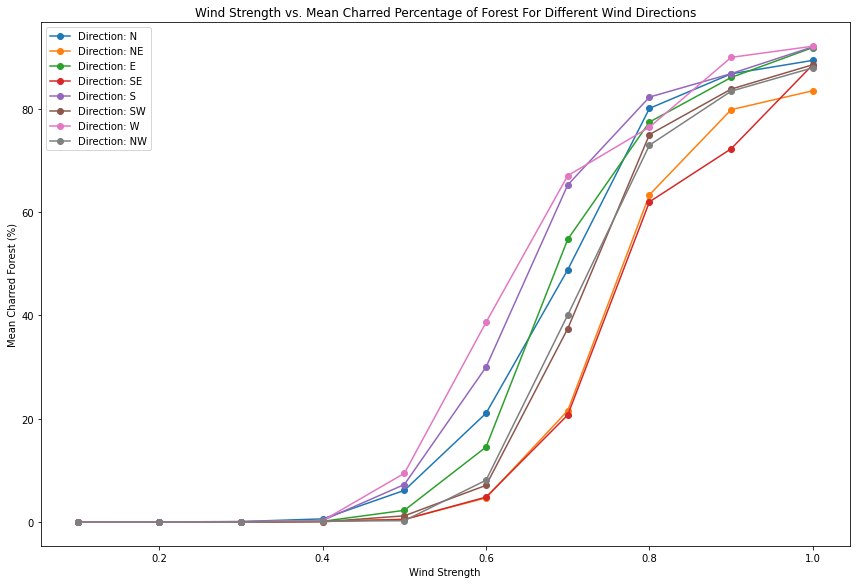

In [84]:
forest_model_analysis = ForestFireModel()
wind_directions = ['N', 'NE', 'E', 'SE', 'S', 'SW', 'W', 'NW']
wind_strengths = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]  
analyze_wind_strength(forest_model_analysis, wind_directions, wind_strengths, num_simulations=10, steps_per_simulation=100)

In [103]:
def plot_burnt_percentage_over_time(model, steps, simulations, wind_strengths):
    plt.figure(figsize=(12, 8))

    for strength in wind_strengths:
        # Reset the model for each wind strength
        model.wind_strength = strength
        model.self_ignition_source = [50, 50]
        
        # Store results for each simulation
        burnt_percentage_data_simulations = []

        for _ in range(simulations):  
            model.initialize_grid()
            burnt_percentage_data = []

            for _ in range(steps):
                model.simulate_step()
                burnt_percentage_data.append(model.collect_percentage_burnt_data())

            # Store the burnt percentage data for the current simulation
            burnt_percentage_data_simulations.append(burnt_percentage_data)

        # Calculate the mean burnt percentage over the 10 simulations
        mean_burnt_percentage = np.mean(np.array(burnt_percentage_data_simulations) * 100, axis=0)

        # Plot the mean burnt percentage over time for the current wind strength
        plt.plot(range(steps), mean_burnt_percentage, label=f'Wind Strength: {strength}', marker='o', markersize=3)

    # Add legend and labels
    plt.title('Mean Burnt Percentage Over Time for Different Wind Strengths (10 Simulations)')
    plt.xlabel('Time Steps')
    plt.ylabel('Mean Charred Forest (%)')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.grid(True)
    plt.show()

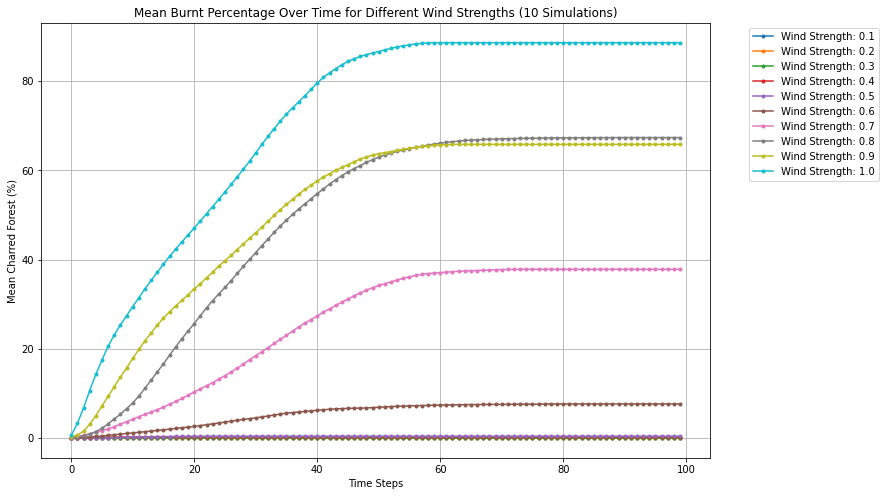

In [104]:
plot_burnt_percentage_over_time(forest_model_analysis, steps=100, simulations=10, wind_strengths=wind_strengths)

In [197]:
def coarse_grain_percentage_burnt(forest, scale_factor):
    coarse_grained_percentage_burnt = np.zeros((forest.shape[0] // scale_factor, forest.shape[1] // scale_factor))

    for i in range(0, forest.shape[0] // scale_factor * scale_factor, scale_factor):
        for j in range(0, forest.shape[1] // scale_factor * scale_factor, scale_factor):
            # Calculate the average percentage of burnt cells for the coarse-grained region
            coarse_grained_percentage_burnt[i // scale_factor, j // scale_factor] = np.mean(
                calculate_percentage_burnt_for_region(forest, i, j, scale_factor)
            )

    return coarse_grained_percentage_burnt


def calculate_percentage_burnt_for_region(forest, i, j, scale_factor):
    # Calculate the percentage of burnt cells for cells in the region
    region_burning_state = forest[i:i + scale_factor, j:j + scale_factor]['burning_state']
    region_percentage_burnt = np.sum(region_burning_state == 2) / region_burning_state.size
    return region_percentage_burnt

def analyze_percentage_burnt_scaling(model, scale_factors):
    percentage_burnt_scaling_data = []

    for scale_factor in scale_factors:
        coarse_grained_percentage_burnt = coarse_grain_percentage_burnt(model.forest, scale_factor)
        average_percentage_burnt = np.mean(coarse_grained_percentage_burnt)

        percentage_burnt_scaling_data.append({
            'Scale Factor': scale_factor,
            'Average Percentage Burnt': average_percentage_burnt
        })

    # Plot the scaling behavior
    scale_factors = [data['Scale Factor'] for data in percentage_burnt_scaling_data]
    average_percentage_burnt = [data['Average Percentage Burnt'] for data in percentage_burnt_scaling_data]

    plt.plot(scale_factors, average_percentage_burnt, marker='o')
    plt.xlabel('Scale Factor')
    plt.ylabel('Average Percentage Burnt')
    plt.title('Scaling Behavior of Percentage Burnt')
    plt.show()

    return percentage_burnt_scaling_data



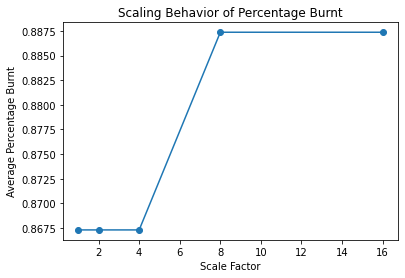

In [221]:
# Initialize the forest fire model

scale_factors_to_test = [1,2, 4, 8, 16]
percentage_burnt_scaling_data = analyze_percentage_burnt_scaling(test_2, scale_factors_to_test)

In [60]:
# Function to run simulations with random wind parameters
def random_testing(model, num_simulations, steps):

    for _ in range(num_simulations):
        # Generate random wind parameters
        wind_direction = random.choice(['N', 'NE', 'NW', 'S', 'SE', 'SW', 'W', 'E'])
        wind_strength = random.randint(1, 10) / 10.0

        # Initialize the model with random wind parameters
        model.__init__(wind_direction=wind_direction, wind_strength=wind_strength)

        # Run simulations
        _, burnt_percentage = model.run_simulations(1, steps)
    
        print(f' Wind Direction: {wind_direction}, Ignition Source: {model.initial_ignition_source}, Wind Strength: {wind_strength}, Percentage Burnt: {round(burnt_percentage[0]*100,2)}')

# Initialize the ForestFireModel and ForestFireAnimation
forest_model = ForestFireModel(tree_density=selected_area)

# Run simulations with random wind parameters
num_simulations = 10
steps_per_simulation = 100
burnt_percentage_data = random_testing(forest_model, num_simulations, steps_per_simulation)



 Wind Direction: NE, Ignition Source: (50, 58), Wind Strength: 0.1, Percentage Burnt: 0.03
 Wind Direction: N, Ignition Source: (82, 25), Wind Strength: 1.0, Percentage Burnt: 91.83
 Wind Direction: W, Ignition Source: (65, 40), Wind Strength: 0.4, Percentage Burnt: 0.05
 Wind Direction: SW, Ignition Source: (59, 17), Wind Strength: 0.8, Percentage Burnt: 71.59
 Wind Direction: NW, Ignition Source: (42, 27), Wind Strength: 0.9, Percentage Burnt: 84.34
 Wind Direction: S, Ignition Source: (91, 55), Wind Strength: 0.7, Percentage Burnt: 64.46
 Wind Direction: E, Ignition Source: (71, 57), Wind Strength: 1.0, Percentage Burnt: 92.09
 Wind Direction: SE, Ignition Source: (39, 4), Wind Strength: 0.7, Percentage Burnt: 29.0
 Wind Direction: SE, Ignition Source: (96, 95), Wind Strength: 0.5, Percentage Burnt: 6.4
 Wind Direction: NE, Ignition Source: (77, 8), Wind Strength: 0.1, Percentage Burnt: 0.01


In [335]:
spread = ForestFireModel(wind_strength=1)
a, b = spread.run_simulations(100,100)

(0.11144178715315235, 0.11184510733593063)

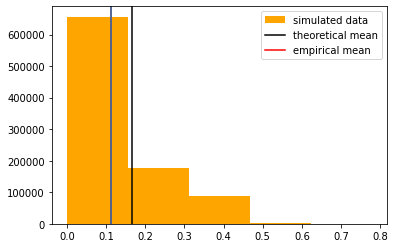

In [347]:
plt.hist(spread.spread_probability, color='orange', label ='simulated data', bins=5, density=False)
plt.axvline(theory, color='black', label = 'theoretical mean')
plt.axvline(np.mean(spread.spread_probability), color='red', label ='empirical mean')
confidence_interval = stats.t.interval(
            0.90, len(spread.spread_probability) - 1,
            loc=np.mean(spread.spread_probability, axis=0),
            scale=stats.sem(spread.spread_probability, axis=0)
        )
plt.axvline(confidence_interval[1])
plt.legend()
confidence_interval

Experimental Theoretical Analysis

In [ ]:
def coarse_grain_probability_of_spread(forest, scale_factor):
    coarse_grained_spread_prob = np.zeros((forest.shape[0] // scale_factor, forest.shape[1] // scale_factor))

    for i_coarse in range(0, forest.shape[0] // scale_factor):
        for j_coarse in range(0, forest.shape[1] // scale_factor):
            # Calculate the average probability of spread for the coarse-grained region
            i = i_coarse * scale_factor
            j = j_coarse * scale_factor
            coarse_grained_spread_prob[i_coarse, j_coarse] = np.mean(
                calculate_spread_prob_for_region(forest, i, j, scale_factor)
            )

    return coarse_grained_spread_prob

def calculate_spread_prob_for_region(forest, i, j, scale_factor):
    # Calculate the average probability of spread for cells in the region
    region_tree_density = forest[i:i + scale_factor, j:j + scale_factor]['tree_density']
    region_spread_prob = np.mean(region_tree_density)  # Replace with your calculation for spread probability
    return region_spread_prob

def analyze_spread_prob_scaling(model, scale_factors):
    spread_prob_scaling_data = []

    for scale_factor in scale_factors:
        coarse_grained_spread_prob = coarse_grain_probability_of_spread(model.forest, scale_factor)
        average_spread_prob = np.mean(coarse_grained_spread_prob)

        spread_prob_scaling_data.append({
            'Scale Factor': scale_factor,
            'Average Spread Probability': average_spread_prob
        })

    # Plot the scaling behavior
    scale_factors = [data['Scale Factor'] for data in spread_prob_scaling_data]
    average_spread_probs = [data['Average Spread Probability'] for data in spread_prob_scaling_data]

    plt.plot(scale_factors, average_spread_probs, marker='o')
    plt.xlabel('Scale Factor')
    plt.ylabel('Average Spread Probability')
    plt.title('Scaling Behavior of Spread Probability')
    plt.show()

    return spread_prob_scaling_data
# Specify scale factors for analysis
scale_factors_to_test = [1,2, 4, 8, 16]

# Perform spread probability scaling analysis
spread_prob_scaling_data = analyze_spread_prob_scaling(test_2, scale_factors_to_test)

In [166]:
from scipy.ndimage import label

def percolation_analysis_ca(coarse_grained_probabilities, threshold):
    # Threshold the coarse-grained probabilities
    binary_map = (coarse_grained_probabilities > threshold).astype(int)

    # Label connected components
    labeled_map, num_clusters = label(binary_map)

    # Analyze the properties of clusters, e.g., size, shape, etc.
    cluster_properties = analyze_clusters(labeled_map, num_clusters)

    return cluster_properties

def analyze_clusters(labeled_map, num_clusters):
    cluster_properties = []

    for i in range(1, num_clusters + 1):
        cluster_indices = np.argwhere(labeled_map == i)
        cluster_size = len(cluster_indices)
        # Add more properties as needed
        cluster_properties.append({'size': cluster_size, 'indices': cluster_indices})

    return cluster_properties


In [178]:
def visualize_clusters(cluster_properties, grid_size):
    # Create an empty grid
    visualization_grid = np.zeros((grid_size, grid_size))

    # Plot each cluster on the grid
    for cluster in cluster_properties:
        cluster_indices = cluster['indices']
        for index in cluster_indices:
            visualization_grid[index[0], index[1]] = 1

    # Plot the grid
    plt.imshow(visualization_grid, cmap='Greens', interpolation='none')
    plt.title('Clusters in Cellular Automata')
    plt.colorbar()
    plt.show()

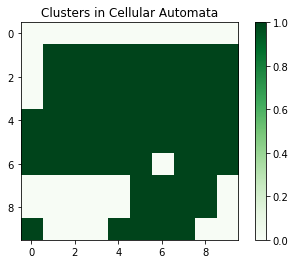

In [191]:
grid_size = 10  # Replace with your actual grid size
cluster_properties = percolation_analysis_ca(coarse_grained_probability,0.5)
visualize_clusters(cluster_properties, grid_size)

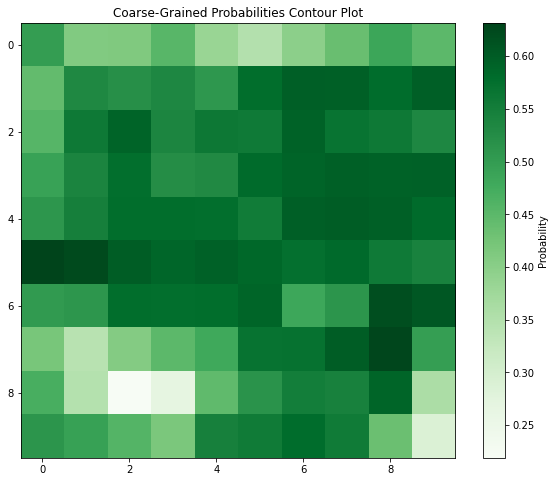

In [184]:
plt.figure(figsize=(10,8))
plt.imshow(coarse_grained_probability, cmap='Greens', interpolation='None')
plt.title('Coarse-Grained Probabilities Contour Plot')
plt.colorbar(label='Probability')
plt.show()

In [ ]:

"""

    def update_wind_conditions(self):
        self.wind_direction += np.random.uniform(-0.1, 0.1)
        self.wind_speed = np.random.uniform(0, 5)

    def update_temperature_and_humidity(self):
        self.temperature += np.random.uniform(-1, 1)
        self.humidity += np.random.uniform(-0.1, 0.1)

        

    def calculate_ignition_probability(self, i, j):
        return self.forest[i, j]['tree_density'] * self.ignition_chance
"""